## The 2023 Data

In [1]:
df <- read.csv("transactionData-4-5-2023.csv")

In [3]:
head(df)

,X,blockNumber,gas,gasPrice,executionGas,callDataUsage,callDataLength,CallData,nonce,to,from
,<int>,<int>,<int>,<dbl>,<int>,<int>,<int>,<chr>,<int>,<dbl>,<dbl>
1,0,16984517,356052,66000000000,355848,204,74,0xefef39a10000000000000000000000000000000000000000000000000000000000000032,10710,9.045893e+47,5.330497e+46
2,1,16984517,200000,57860000000,199404,596,138,0xa9059cbb000000000000000000000000b4d51c80006394122e481cf447a6579adbff3d8d00000000000000000000000000000000000000000000000000000004e3b29200,1326593,9.175511e+47,1.461056e+48
3,2,16984517,350000,44118983676,349392,608,138,0xa9059cbb0000000000000000000000004c97f6e3a841c44d68547ecb724c1ff1b9759786000000000000000000000000000000000000000000000000000000007694fa1d,8475807,1.248875e+48,4.007900e+47
4,3,16984517,350000,44118983676,349392,608,138,0xa9059cbb000000000000000000000000ffaba2f149672384d9693cf6a8fd6a1cc863fda500000000000000000000000000000000000000000000000000000000744f15e0,8475808,1.248875e+48,4.007900e+47
5,4,16984517,350000,44118983676,350000,0,2,0x,8475809,1.370721e+48,4.007900e+47
6,5,16984517,350000,44118983676,350000,0,2,0x,8475810,2.163258e+47,4.007900e+47


In [3]:
str(df)

'data.frame':	15827 obs. of  11 variables:
 $ X             : int  0 1 2 3 4 5 6 7 8 9 ...
 $ blockNumber   : int  16984517 16984517 16984517 16984517 16984517 16984517 16984517 16984517 16984517 16984517 ...
 $ gas           : int  356052 200000 350000 350000 350000 350000 1000000 1000000 1500000 21000 ...
 $ gasPrice      : num  6.60e+10 5.79e+10 4.41e+10 4.41e+10 4.41e+10 ...
 $ executionGas  : int  355848 199404 349392 349392 350000 350000 999392 999332 1498128 21000 ...
 $ callDataUsage : int  204 596 608 608 0 0 608 668 1872 0 ...
 $ callDataLength: int  74 138 138 138 2 2 138 138 458 2 ...
 $ CallData      : chr  "0xefef39a10000000000000000000000000000000000000000000000000000000000000032" "0xa9059cbb000000000000000000000000b4d51c80006394122e481cf447a6579adbff3d8d0000000000000000000000000000000000000"| __truncated__ "0xa9059cbb0000000000000000000000004c97f6e3a841c44d68547ecb724c1ff1b97597860000000000000000000000000000000000000"| __truncated__ "0xa9059cbb000000000000000000000000ff

In [2]:
library(dplyr)


Attaching package: 'dplyr'


The following objects are masked from 'package:stats':

    filter, lag


The following objects are masked from 'package:base':

    intersect, setdiff, setequal, union




In [3]:
df <-select(df,-X)

In [6]:
head(df)

,blockNumber,gas,gasPrice,executionGas,callDataUsage,callDataLength,CallData,nonce,to,from
,<int>,<int>,<dbl>,<int>,<int>,<int>,<chr>,<int>,<dbl>,<dbl>
1,16984517,356052,66000000000,355848,204,74,0xefef39a10000000000000000000000000000000000000000000000000000000000000032,10710,9.045893e+47,5.330497e+46
2,16984517,200000,57860000000,199404,596,138,0xa9059cbb000000000000000000000000b4d51c80006394122e481cf447a6579adbff3d8d00000000000000000000000000000000000000000000000000000004e3b29200,1326593,9.175511e+47,1.461056e+48
3,16984517,350000,44118983676,349392,608,138,0xa9059cbb0000000000000000000000004c97f6e3a841c44d68547ecb724c1ff1b9759786000000000000000000000000000000000000000000000000000000007694fa1d,8475807,1.248875e+48,4.007900e+47
4,16984517,350000,44118983676,349392,608,138,0xa9059cbb000000000000000000000000ffaba2f149672384d9693cf6a8fd6a1cc863fda500000000000000000000000000000000000000000000000000000000744f15e0,8475808,1.248875e+48,4.007900e+47
5,16984517,350000,44118983676,350000,0,2,0x,8475809,1.370721e+48,4.007900e+47
6,16984517,350000,44118983676,350000,0,2,0x,8475810,2.163258e+47,4.007900e+47


In [4]:
group_callData <- function(x){
    if (x==0){
        return('0')
    }else if (x==64){
        return('64')
    }else if (x==204){
        return('204')
    }else if (x==264){
        return('264')
    }else if (x==608){
        return('608')
    }else if (x==680){
        return('680')
    }else if (x==976){
        return('976')
    }else if (x==1688){
        return('1688')
    }else if (x==1824){
        return('1824')
    }else{
        return('Other')      
    }
}

In [5]:
df$callDataUsageGroups<-as.factor(sapply(df$callDataUsage,group_callData))

In [6]:
table(df$callDataUsageGroups)/dim(df)[1]


           0         1688         1824          204          264          608 
0.3436532508 0.0001895495 0.0010741139 0.0290642573 0.0065078663 0.0648891135 
          64          680          976        Other 
0.0201554306 0.0039173564 0.0020218614 0.5285272004 

In [7]:
library(ggplot2)

Warning message:
"Using `size` aesthetic for lines was deprecated in ggplot2 3.4.0.
ℹ Please use `linewidth` instead."
Saving 6.67 x 6.67 in image


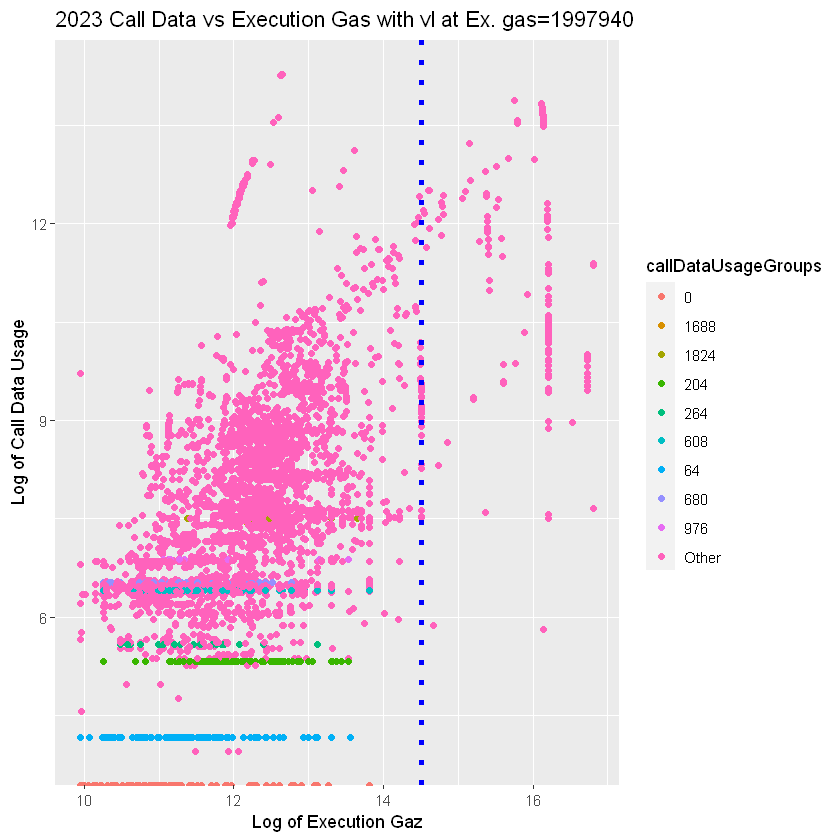

In [14]:
ggplot(df)  +
  geom_point(aes(x = log(executionGas), y = log(callDataUsage),color=callDataUsageGroups)) +labs(y= "Log of Call Data Usage", x = "Log of Execution Gaz")+geom_vline(xintercept=log(1997940),linetype="dotted", 
                color = "blue", size=1.5)+ ggtitle("2023 Call Data vs Execution Gas with vl at Ex. gas=1997940")
ggsave("plot2.png")

In [15]:
df[df$executionGas<exp(17) & (df$executionGas>exp(16)),]

blockNumber gas      gasPrice    executionGas callDataUsage
317   16984519    18500000 35193881648 18483520     16480        
876   16984523    18500000 33776508340 18485404     14596        
1331  16984526    20000000 31367981752 19911180     88820        
1421  16984527    18500000 33626583337 18487276     12724        
2078  16984531    18500000 32891826049 18486328     13672        
2635  16984534    18500000 31764039393 18487276     12724        
3307  16984536    15000000 34481575046 14992196      7804        
3399  16984537    18500000 35245010653 18486280     13720        
4029  16984540    18500000 34591605162 18487264     12736        
4456  16984542    18500000 37551050019 18481516     18484        
4661  16984543    20000000 37325718437 19997896      2104        
4969  16984545    10198000 38083898888 10197668       332        
5121  16984546    18500000 35907640849 18484384     15616        
5557  16984549    18500000 33519799184 18478768     21232        
6204  16984553    18500000 35037628306 18487252     12748        
6631  16984556    18500000 33222803952 18487216     12784        
7326  16984560    18500000 35830176342 18486352     13648        
7957  16984564    18500000 36960918194 18484420     15580        
8309  16984566    18500000 38072975485 18486316     13684        
8769  16984569    18500000 39636308149 18485356     14644        
9192  16984572    18500000 37930425661 18485320     14680        
9758  16984576    20000000 34303930090 19913772     86228        
9890  16984577    20000000 34921321186 19913772     86228        
10004 16984578    18500000 34898378921 18485332     14668        
10306 16984580    18500000 33965299020 18479668     20332        
10978 16984585    18500000 34958413027 18487216     12784        
11583 16984589    18500000 32510048441 18487216     12784        
12067 16984592    18500000 33644155573 18486304     13696        
12695 16984596    18500000 32910961785 18486316     13684        
13146 16984599    18500000 33282840257 18477892     22108        
⋮     ⋮           ⋮        ⋮           ⋮            ⋮            
15500 16984614    11000000 39380759847 10998060        1940      
15501 16984614    11000000 39380759847 10981180       18820      
15502 16984614    11000000 39380759847 10206956      793044      
15503 16984614    11000000 39380759847 10966856       33144      
15504 16984614    11000000 39380759847 10998188        1812      
15505 16984614    11000000 39380759847 10976128       23872      
15506 16984614    11000000 39380759847 10976132       23868      
15507 16984614    11000000 39380759847  9986584     1013416      
15509 16984614    11000000 39380759847 10973864       26136      
15510 16984614    11000000 39380759847 10122020      877980      
15647 16984615    11000000 39315451466 10964860       35140      
15649 16984615    11000000 39315451466 10207704      792296      
15650 16984615    11000000 39315451466 10971960       28040      
15651 16984615    11000000 39315451466 10270516      729484      
15652 16984615    11000000 39315451466 10982576       17424      
15654 16984615    11000000 39315451466 10221552      778448      
15655 16984615    11000000 39315451466 10973840       26160      
15656 16984615    11000000 39315451466 10114404      885596      
15659 16984615    11000000 39315451466 10973124       26876      
15660 16984615    11000000 39315451466  9996608     1003392      
15783 16984616    11000000 40720449057 10964376       35624      
15784 16984616    11000000 40720449057 10223608      776392      
15785 16984616    11000000 40720449057 10962580       37420      
15786 16984616    11000000 40720449057 10206976      793024      
15787 16984616    11000000 40720449057 10976524       23476      
15788 16984616    11000000 40720449057 10115336      884664      
15789 16984616    11000000 40720449057 10949360       50640      
15790 16984616    11000000 40720449057 10116796      883204      
15791 16984616    11000000 40720449057 1097936

Saving 6.67 x 6.67 in image


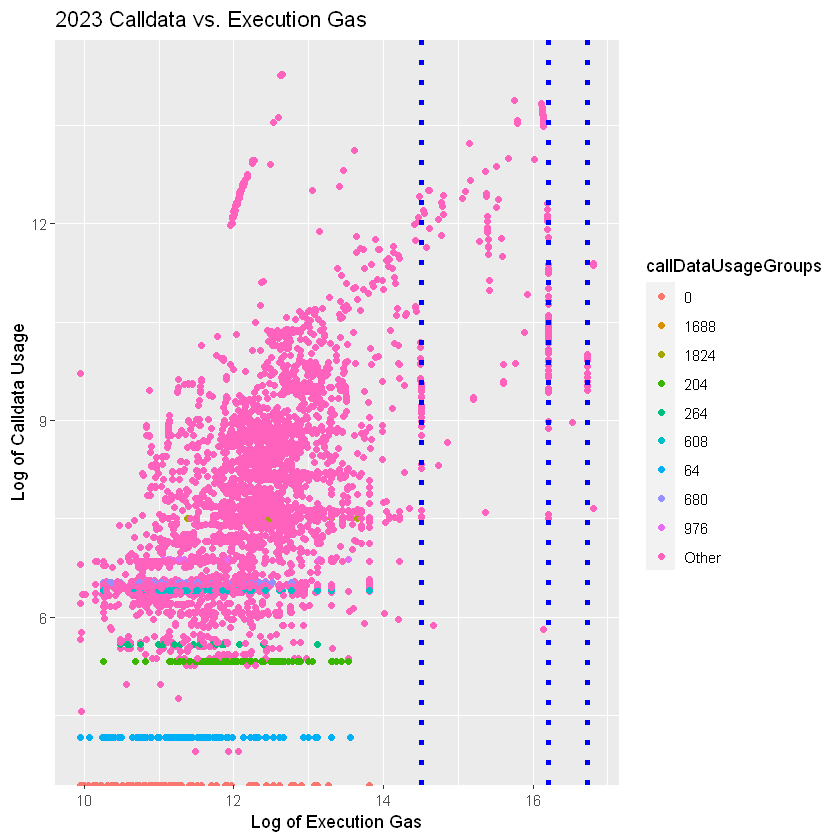

In [13]:
ggplot(df)  +
  geom_point(aes(x = log(executionGas), y = log(callDataUsage),color=callDataUsageGroups)) +labs(y= "Log of Calldata Usage", x = "Log of Execution Gas")+geom_vline(xintercept=log(1997940),linetype="dotted", 
                color = "blue", size=1.5)+ ggtitle("2023 Call Data vs Execution Gas")+geom_vline(xintercept=log(18487276),linetype="dotted", 
                color = "blue", size=1.5)+geom_vline(xintercept=log(10998060),linetype="dotted", 
                color = "blue", size=1.5)+ ggtitle("2023 Calldata vs. Execution Gas")
ggsave("plot2.png")

Saving 6.67 x 6.67 in image


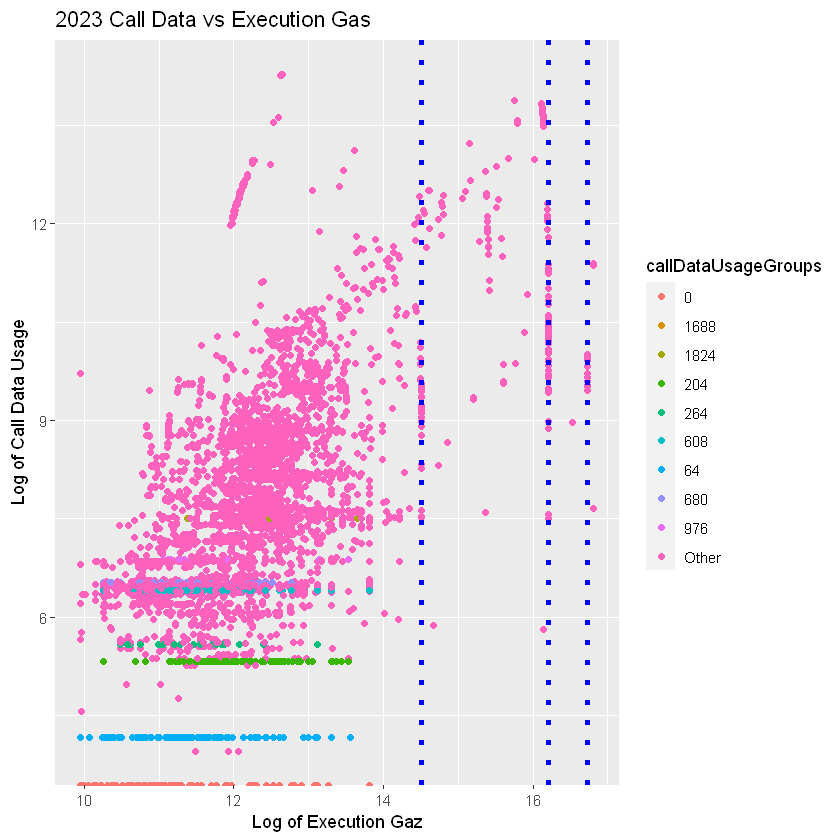

In [11]:
ggplot(df)  +
  geom_point(aes(x = log(executionGas), y = log(callDataUsage),color=callDataUsageGroups)) +labs(y= "Log of Call Data Usage", x = "Log of Execution Gaz")+geom_vline(xintercept=log(1997940),linetype="dotted", 
                color = "blue", size=1.5)+geom_vline(xintercept=log(18487276),linetype="dotted", 
                color = "blue", size=1.5)+geom_vline(xintercept=log(10998060),linetype="dotted", 
                color = "blue", size=1.5)+ ggtitle("2023 Call Data vs Execution Gas")
ggsave("plot2b.png")

In [42]:
#HL: 1997940,10998060,18487276

group_exeGas <- function(x){
    if (x>=1997941) & (x<=1997939){
        return('14.51')
    }else if (x>=10998061) & (x>=10998061){
        return('16.21')
    }else if (x==18487276){
        return('16.73')
    }else{
        return('Other')      
    }
}

In [43]:
df$exeGasGroups<-as.factor(sapply(df$executionGas,group_exeGas))

In [44]:
table(df$exeGasGroups)


14.51 16.21 16.73 Other 
    3     3    18 15803 

In [23]:
df[df$executionGas<exp(15) & (df$executionGas>exp(14)),]

blockNumber gas     gasPrice    executionGas callDataUsage callDataLength
9     16984517    1500000 42023618786 1498128        1872          458         
48    16984517    1990098 34023618786 1830682      159416        54618         
346   16984519    2261368 33693881648 2148356      113012        32202         
362   16984519    2390554 32433881648 2239154      151400        51546         
452   16984520    2244872 34100000000 2045380      199492        71242         
719   16984522    1380876 33000000000 1285492       95384        25482         
1135  16984525    2198740 35000000000 1953096      245644        74578         
1156  16984525    2825934 32175260911 2820150        5784         1802         
1176  16984525    2000000 31175260911 1985172       14828         3402         
1183  16984525    2000000 31175260911 1986520       13480         2890         
1344  16984526    1567010 30467981752 1466766      100244        28170         
1465  16984527    1228536 32339583337 1226832        1704          458         
1827  16984529    2454414 29790869762 2186618      267796        53962         
1828  16984529    2466981 32077077963 2199173      267808        53962         
1967  16984530    2000000 31354498420 1985836       14164         3274         
2050  16984530    1900000 30454498420 1854900       45100         9226         
2982  16984534    1227028 28944039393 1226600         428          138         
3016  16984534    2850402 28864039393 2640462      209940        71258         
3042  16984534    2000000 28864039393 1998152        1848          458         
3081  16984534    2500000 28824510389 2495916        4084         1546         
3156  16984535    2000000 32345070445 1986368       13632         3146         
3160  16984535    2000000 32345070445 1980844       19156         4042         
3176  16984535    1363418 31645070445 1353778        9640         2764         
3561  16984538    1481772 33098124954 1416280       65492        19338         
3793  16984539    2000000 32245010653 1998128        1872          458         
4072  16984540    2748856 33091605162 2612368      136488        39626         
4097  16984540    2000000 32591605162 1990924        9076         2122         
4102  16984540    2000000 32591605162 1987324       12676         2698         
4362  16984541    1461736 36645194766 1389772       71964        20426         
4876  16984544    2000000 35113837792 1992592        7408         1738         
⋮     ⋮           ⋮       ⋮           ⋮            ⋮             ⋮             
11299 16984587    2000000 31463483378 1987432       12568         2890         
11603 16984589    1259912 31510048441 1257576        2336          522         
11724 16984590    2845163 32875357883 2618999      226164        73370         
11798 16984590    1500000 31469736656 1455584       44416         8074         
11799 16984590    1653418 31380971395 1613042       40376        10122         
11929 16984591    1257212 32959932435 1254876        2336          522         
12094 16984592    2000000 31644155573 1990368        9632         2250         
12095 16984592    2000000 31644155573 1984624       15376         3274         
12244 16984593    1475609 29994058045 1371169      104440        13234         
12391 16984594    2000000 29744309672 1997940        2060          522         
12486 16984594    2089949 28675252997 1922849      167100        54098         
12511 16984595    1492434 31585137834 1473130       19304         6282         
12873 16984597    1600000 31277888251 1586212       13788         3722         
12927 16984597    2000000 32277888251 1990380        9620         2250         
13398 16984600    1900000 30208947861 1853824       46176         9482         
13640 16984602    2000000 31475969314 1990912        9088         2122         
13648 16984602    2000000 31475969314 1980904       19096         4042         
13923 16984604    2341000 28644175688 2340644         356          138         
13955 

In [22]:
df[df$executionGas==18487216,]

,blockNumber,gas,gasPrice,executionGas,callDataUsage,callDataLength,CallData,nonce,to,from,callDataUsageGroups,exeGasGroups
,<int>,<int>,<dbl>,<int>,<int>,<int>,<chr>,<int>,<dbl>,<dbl>,<fct>,<fct>
6631,16984556,18500000,33222803952,18487216,12784,2890,0xd3a86ca00000000000000000000000000000000000000000000000000000000000000080000000000000000000000000000000000000000000000000000000000000022000000000000000000000000000000000000000000000000000000000000003c00000000000000000000000000000000000000000000000000000000000000400000000000000000000000000000000000000000000000000000000000000000c0000000000000000000000004c2523cea7a35c74a794ff14b80e7bed6f9fab4f000000000000000000000000077d360f11d220e4d5d831430c81c26c9be7c4a40000000000000000000000000505fc87c1ebb331295c965230d17324541da9f40000000000000000000000000778fcfacd22da84890b6d7f38c32d4a0e3bc4a400000000000000000000000054cd47c2f0fb09c468e15344fd68c54272d572460000000000000000000000000505fc864059d112e8df756e837a584c541da9f40000000000000000000000004c2523cc6a251d70822293d35d1a6d3c6f9fab4f0000000000000000000000000e309daefb14c817462579c5bb8074070bbef58f000000000000000000000000439fa9569c5352740883cffb3c09265862c7d7b4000000000000000000000000453ae32e495688af433c455933ee034b2c8125060000000000000000000000000e309da3f5daf0e545335e3332b9d0a70bbef58f000000000000000000000000453a0f3d494de32c5fbf5ddd20012e2639c92506000000000000000000000000000000000000000000000000000000000000000c0000000000000000000000003ba194ad1394011b9ae2eefd6618b562dc279a7f0000000000000000000000003114aaaea2ad81a930d9f376121b8636e2f8eb8a000000000000000000000000f3b4b74e19b6c58c2d16edad921feea729664f3f000000000000000000000000311404c5868ca9a380806de773249f8dd25ceb8a0000000000000000000000006b1dd11bbc2aa8e0358cc4c3921a6484cd5577f3000000000000000000000000f3b4be82fb2916a6bae3ee9e44497e5b69434f3f0000000000000000000000003ba194a02a94582af851b4422ba2e52bdc279a7f000000000000000000000000c19c33db8bc6bddc0a32b51b75aad9580f4e73060000000000000000000000000dc4ad07be9ba650989557feb40661eec427fc17000000000000000000000000ba7ef2854add1835876b71469759c2c197ce1ddf000000000000000000000000c199127f631ec09ffd92034db8064da205a77306000000000000000000000000ba7bdf1f69e3af0d164d67d53b330a9195471ddf000000000000000000000000000000000000000000000000000000000000000c3035303535303030353030300000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000c0000000000000000000000000000000000000000000000066f05d7ea255c7800000000000000000000000000000000000000000000000000000200a416c3f9800000000000000000000000000000000000000000000000008ac7230489e80000000000000000000000000000000000000000000000000000000200a416c3f98000000000000000000000000000000000000000000000000000038d7ea4c680000000000000000000000000000000000000000000000000008ac7230489e800000000000000000000000000000000000000000000000000066f05d7ea255c78000000000000000000000000000000000000000000000000003e3debbcc9a08000000000000000000000000000000000000000000000000000000096b08c5c166800000000000000000000000000000000000000000000000001b88957d02600000000000000000000000000000000000000000000000000003e3debbcc9a0800000000000000000000000000000000000000000000000000001b88957d0260000,18649,1.076068e+48,2.528923e+47,Other,Other
10978,16984585,18500000,34958413027,18487216,12784,2890,0xd3a86ca00000000000000000000000000000000000000000000000000000000000000080000000000000000000000000000000000000000000000000000000000000022000000000000000000000000000000000000000000000000000000000000003c00000000000000000000000000000000000000000000000000000000000000400000000000000000000000000000000000000000000000000000000000000000c0000000000000000000000003d9ba2c7c6c82a4cfaef84f20e26c8e4c2c6eedf0000000000000000000000003d9ba2c5b39de2a6ae287b05f3ff2a0fc2c6eedf000000000000000000000000d9f1715ef63d014caa2d0ebb438111fa0bf985ba00000000000000000000000088842c9885051e3a14dca5c8a74b50b6ed9052d4000000000000000000000000fe57185e6a064535c3d4d1295e62d1d00928ad2f0000000000000000000000003ba8b2a544c973056be1e952d9fbe85693e5e78f000000000000000000000000d9f125bac730b20e04d

In [ ]:
df[df$executionGas<exp(17) & (df$executionGas>exp(16)),]